# TODO

  - [x] детектирование линий (стрелки)
  - [ ] фильтрация/кластеризация найденных линий (стрелки)
  - [x] поиск цифровых надписей
  - [ ] фильтрация/кластеризация найденных цифровых надписей, приведение показаний стрелки к шкале
  - [ ] детектирование циферблата

# Инициализация

In [2]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
from pillow_heif import register_heif_opener
import math

register_heif_opener()

%matplotlib widget

# Предварительная установка

In [1]:
!pip install pillow_heif

     ---------------------------------------- 5.5/5.5 MB 4.1 MB/s eta 0:00:00


# HoughCircles 1

In [2]:
def avg_circles(circles, b):
    avg_x=0
    avg_y=0
    avg_r=0
    for i in range(b):
        #optional - average for multiple circles (can happen when a gauge is at a slight angle)
        avg_x = avg_x + circles[0][i][0]
        avg_y = avg_y + circles[0][i][1]
        avg_r = avg_r + circles[0][i][2]
    avg_x = int(avg_x/(b))
    avg_y = int(avg_y/(b))
    avg_r = int(avg_r/(b))
    return avg_x, avg_y, avg_r

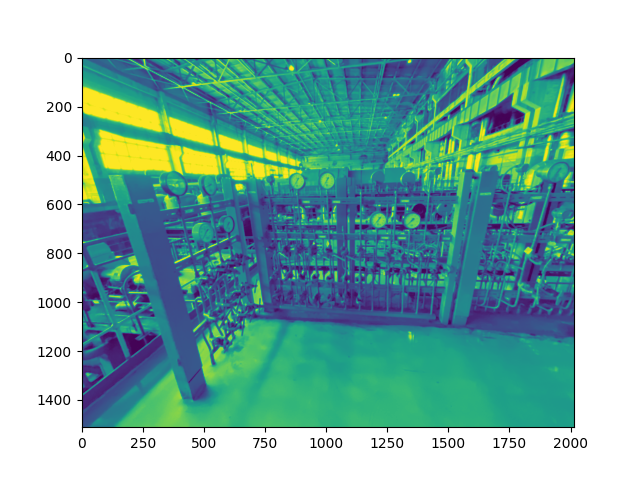

In [3]:
img_color = cv2.imread('images/17.jpeg')
height, width = img_color.shape[:2]
img_resized = cv2.resize(img_color, (width // 2, height // 2), interpolation= cv2.INTER_LINEAR)

# print(img_color)

img_gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)  #convert to gray
img_gray = cv2.GaussianBlur(img_gray, (5, 5), 0)
img_gray = cv2.medianBlur(img_gray, 5)
    
plt.imshow(img_gray, cmap='gray')
plt.show()

In [8]:
# circles = cv2.HoughCircles(img_gray, cv2.HOUGH_GRADIENT, 1.2, 20)#, np.array([]), 100, 50, int(height*0.35), int(height*0.48))

circles = cv2.HoughCircles(
    img_gray,
    cv2.HOUGH_GRADIENT,
    1,
    20,
    np.array([]),
    param1=100,
    param2=50,
    minRadius = int(height*0.005),
    maxRadius = int(height*0.05))

In [11]:
circles.shape

(1, 1138, 3)

In [8]:
# average found circles, found it to be more accurate than trying to tune HoughCircles parameters to get just the right one
a, b, c = circles.shape
x,y,r = avg_circles(circles, b)

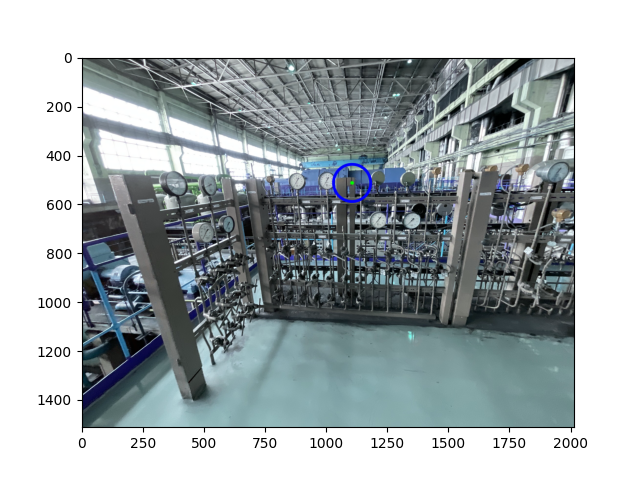

In [9]:
img_disp = img_resized.copy()
cv2.circle(img_disp, (x, y), r, (0, 0, 255), 10, cv2.LINE_AA)  # draw circle
cv2.circle(img_disp, (x, y), 2, (0, 255, 0), 10, cv2.LINE_AA)  # draw center of circle
plt.imshow(img_disp)
plt.show()

# HoughCircles 2

https://russianblogs.com/article/3973607748/

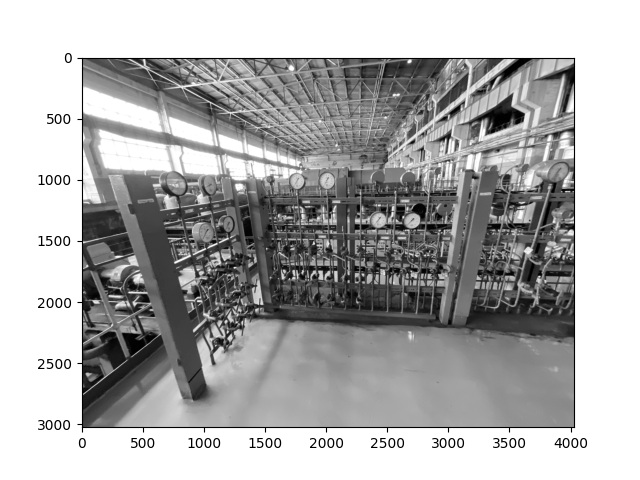

In [20]:
img = cv2.imread('images/17.jpeg')
GrayImage=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
GrayImage= cv2.medianBlur(GrayImage,5)
fig = plt.figure()
plt.imshow(GrayImage, cmap='gray')
plt.show()

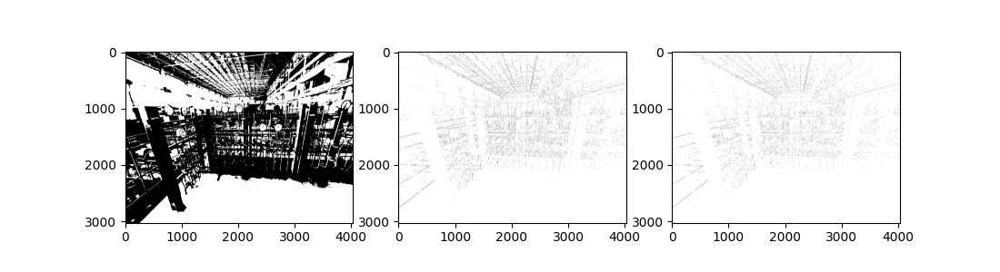

In [21]:
ret,th1 = cv2.threshold(GrayImage,127,255,cv2.THRESH_BINARY)
th2 = cv2.adaptiveThreshold(GrayImage,255,cv2.ADAPTIVE_THRESH_MEAN_C,  
                    cv2.THRESH_BINARY,3,5)  
th3 = cv2.adaptiveThreshold(GrayImage,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,  
                    cv2.THRESH_BINARY,3,5)

fig = plt.figure(figsize = (11,3))
plt.subplot(1, 3, 1)
plt.imshow(th1, cmap='gray')
plt.subplot(1, 3, 2)
plt.imshow(th2, cmap='gray')
plt.subplot(1, 3, 3)
plt.imshow(th3, cmap='gray')
plt.show()

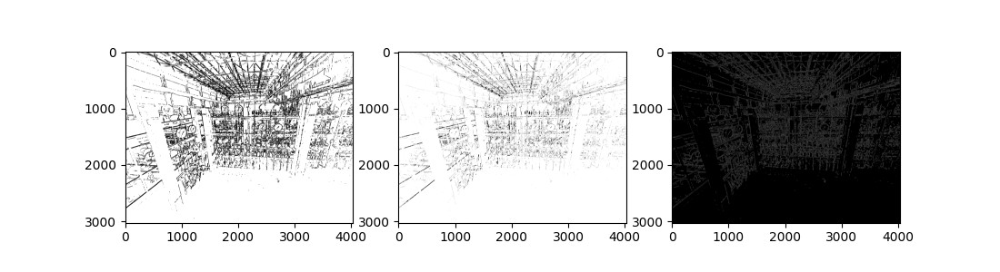

In [22]:
kernel = np.ones((5,5),np.uint8)
erosion = cv2.erode(th2,kernel,iterations=1)
dilation = cv2.dilate(erosion,kernel,iterations=1)
imgray=cv2.Canny(erosion,30,100)

fig = plt.figure(figsize = (11,3))
plt.subplot(1, 3, 1)
plt.imshow(erosion, cmap='gray')
plt.subplot(1, 3, 2)
plt.imshow(dilation, cmap='gray')
plt.subplot(1, 3, 3)
plt.imshow(imgray, cmap='gray')
plt.show()

In [23]:
# # для 17
circles = cv2.HoughCircles(GrayImage,cv2.HOUGH_GRADIENT,1,50,
                           param1=50,param2=40,
                           minRadius=50,maxRadius=70)

# для 23
# circles = cv2.HoughCircles(GrayImage,cv2.HOUGH_GRADIENT,1,50,
#                            param1=100,param2=70,
#                            minRadius=100,maxRadius=200)

# для 6
# circles = cv2.HoughCircles(imgray,cv2.HOUGH_GRADIENT,1,50,
#                            param1=100,param2=90,
#                            minRadius=600,maxRadius=750)

print(circles)
circles = np.uint16(np.around(circles))

[[[2419.5 1332.5   62.8]
  [1996.5 1012.5   68.3]
  [2697.5 1340.5   68.3]
  [1763.5 1020.5   68.3]
  [1176.5 1357.5   58.3]]]


center= (2420, 1332)
center= (1996, 1012)
center= (2698, 1340)
center= (1764, 1020)
center= (1176, 1358)
5


C:\Users\1PC\AppData\Local\Temp\ipykernel_18964\812012655.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize = (11,11))


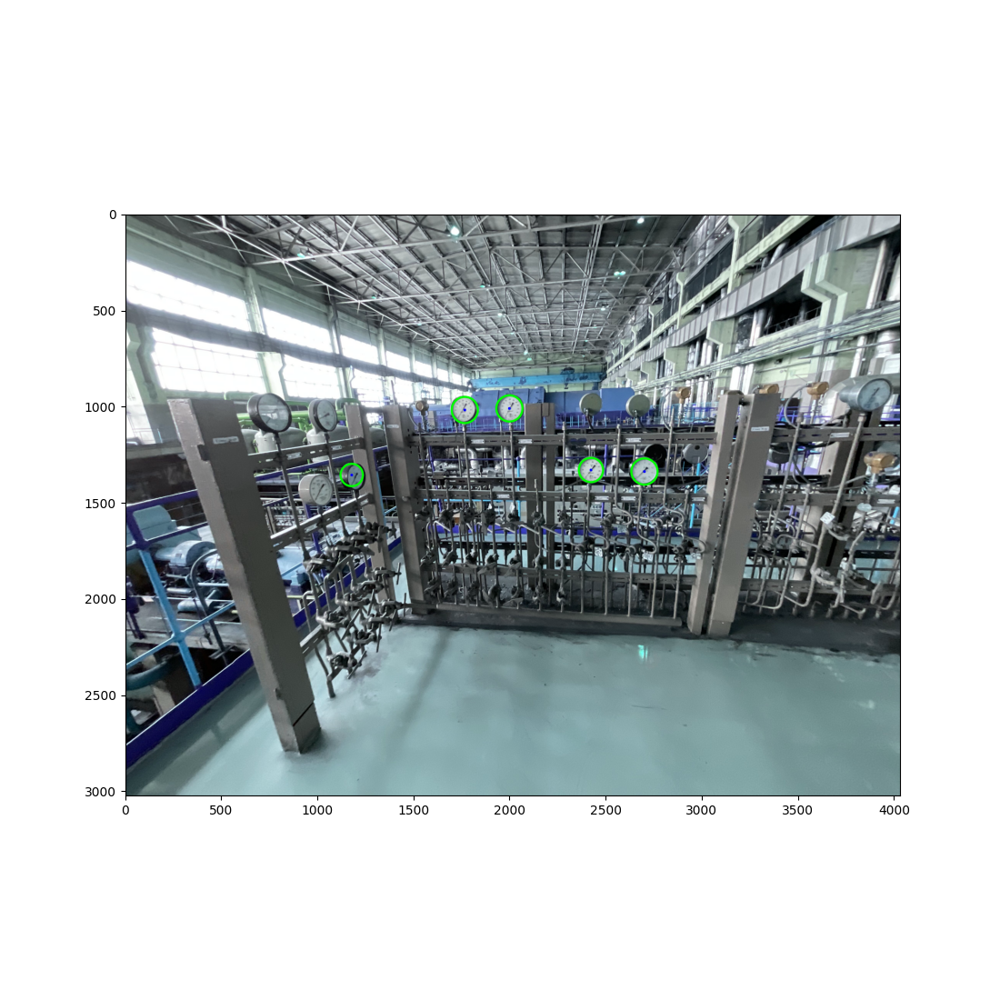

In [25]:
img_copy = img.copy()
for i in circles[0,:]:
    # draw the outer circle
    center = (i[0],i[1])
    print("center=", center)
    cv2.circle(img_copy,(i[0],i[1]),i[2],(0,255,0),10)
    # draw the center of the circle
    cv2.circle(img_copy,(i[0],i[1]),2,(0,0,255),10)
print(len(circles[0,:]))

fig = plt.figure(figsize = (11,11))
plt.imshow(img_copy)
plt.show()

# SimpleBlobDetector

https://stackoverflow.com/questions/39862630/simpleblobdetector-not-recognizing-the-more-obvious-circles

https://www.geeksforgeeks.org/find-circles-and-ellipses-in-an-image-using-opencv-python/

(<KeyPoint 0000020E819A86F0>, <KeyPoint 0000020E805119F0>, <KeyPoint 0000020E973B2720>)


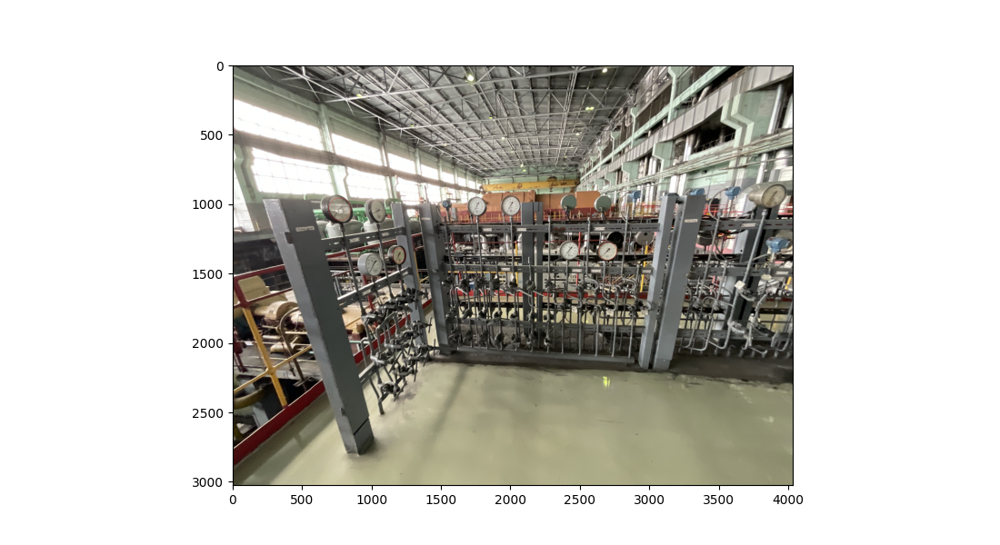

In [26]:
# Load image
pillow_image = Image.open("images/Манометр 17.heic")
img = np.array(pillow_image)
img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) 
 
# Set our filtering parameters
# Initialize parameter settiing using cv2.SimpleBlobDetector
params = cv2.SimpleBlobDetector_Params()
 
# Set Area filtering parameters
params.filterByArea = True
params.minArea = 40*40
params.maxArea = 2000*2000
 
# Set Circularity filtering parameters
params.filterByCircularity = True
params.minCircularity = 0.5
 
# Set Convexity filtering parameters
params.filterByConvexity = True
params.minConvexity = 0.5
     
# Set inertia filtering parameters
params.filterByInertia = True
params.minInertiaRatio = 0.001
 
# Create a detector with the parameters
detector = cv2.SimpleBlobDetector_create(params)
     
# Detect blobs
keypoints = detector.detect(th5)
print(keypoints)
# Draw blobs on our image as red circles
blank = np.zeros((10, 10))
blobs = cv2.drawKeypoints(img.copy(), keypoints, blank, (255, 0, 0),
                          cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS | cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)#cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
plt.figure(figsize = (11,6))
plt.imshow(blobs)
plt.show()

# Разная бинаризация и оконтуривание

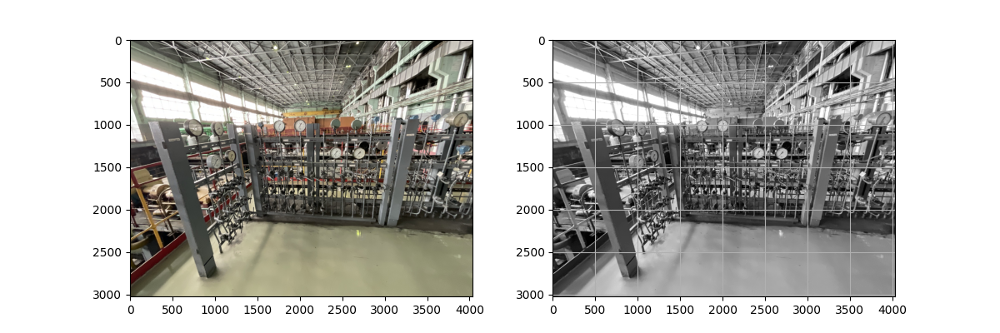

In [29]:
pillow_image = Image.open("images/Манометр 17.heic")
img = np.array(pillow_image)
img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) 
plt.figure(figsize = (12,4))
plt.subplot(1,2,1)
plt.imshow(img)
plt.subplot(1,2,2)
plt.imshow(img_gray, cmap='gray')
plt.grid()
plt.show()

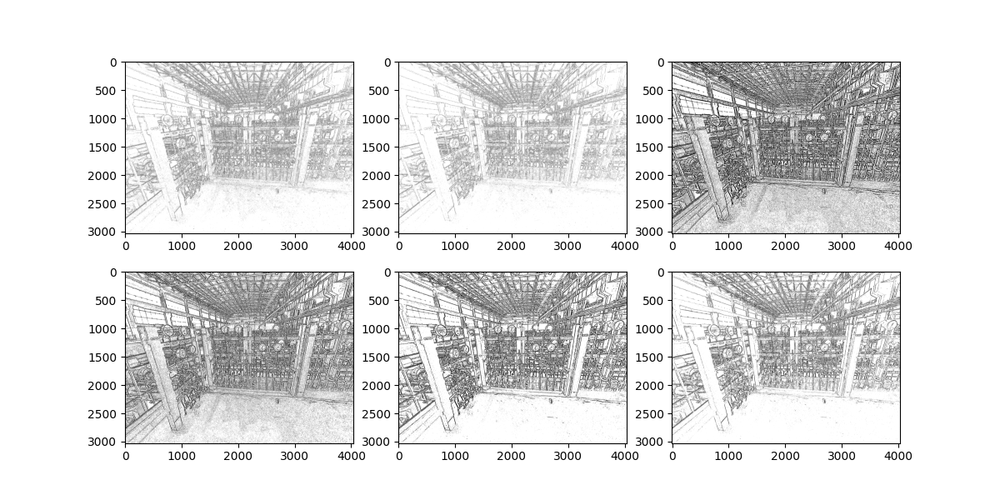

In [30]:
ret,th1 = cv2.threshold(img_gray,127,255,cv2.THRESH_BINARY)

th2 = cv2.adaptiveThreshold(img_gray,255,cv2.ADAPTIVE_THRESH_MEAN_C,  
                    cv2.THRESH_BINARY,3,2)  
th3 = cv2.adaptiveThreshold(img_gray,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,  
                    cv2.THRESH_BINARY,3,2)
th4 = cv2.adaptiveThreshold(img_gray,255,cv2.ADAPTIVE_THRESH_MEAN_C,  
                    cv2.THRESH_BINARY,15,2)  
th5 = cv2.adaptiveThreshold(img_gray,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,  
                    cv2.THRESH_BINARY,15,2)
th6 = cv2.adaptiveThreshold(img_gray,255,cv2.ADAPTIVE_THRESH_MEAN_C,  
                    cv2.THRESH_BINARY,15,5)  
th7 = cv2.adaptiveThreshold(img_gray,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,  
                    cv2.THRESH_BINARY,15,5)

# чем меньше размер блока - тем больше шумов
# чем меньше константа C - тем жирнее линии, и их больше на изображении. Но больше шумов

# Otsu's thresholding
# ret2,th4 = cv2.threshold(img_gray,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
# Otsu's thresholding after Gaussian filtering
# blur = cv2.GaussianBlur(img_gray,(5,5),0)
# ret3,th5 = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

fig = plt.figure(figsize = (12,6))

plt.subplot(2, 3, 1)
plt.imshow(th2, cmap='gray')
plt.subplot(2, 3, 2)
plt.imshow(th3, cmap='gray')
plt.subplot(2, 3, 3)
plt.imshow(th4, cmap='gray')
plt.subplot(2, 3, 4)
plt.imshow(th5, cmap='gray')
plt.subplot(2, 3, 5)
plt.imshow(th6, cmap='gray')
plt.subplot(2, 3, 6)
plt.imshow(th7, cmap='gray')

plt.show()

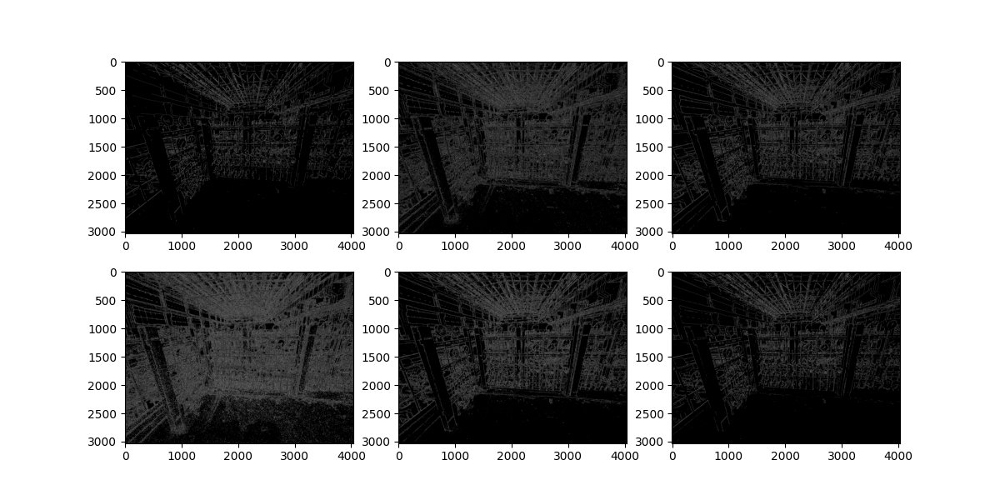

In [4]:
edges1 = cv2.Canny(img_gray,100,200)
edges2 = cv2.Canny(cv2.GaussianBlur(img_gray, (5, 5), 0),20,20)
edges3 = cv2.Canny(cv2.medianBlur(img_gray, 5),50,50)
edges4 = cv2.Canny(img_gray,20,20)
edges5 = cv2.Canny(img_gray,50,50)
edges6 = cv2.Canny(img_gray,100,100)

plt.figure(figsize = (12,6))

plt.subplot(2, 3, 1)
plt.imshow(edges1, cmap='gray')
plt.subplot(2, 3, 2)
plt.imshow(edges2, cmap='gray')
plt.subplot(2, 3, 3)
plt.imshow(edges3, cmap='gray')
plt.subplot(2, 3, 4)
plt.imshow(edges4, cmap='gray')
plt.subplot(2, 3, 5)
plt.imshow(edges5, cmap='gray')
plt.subplot(2, 3, 6)
plt.imshow(edges6, cmap='gray')

plt.show()

# HoughCircles3

1
163
1
2
2
2


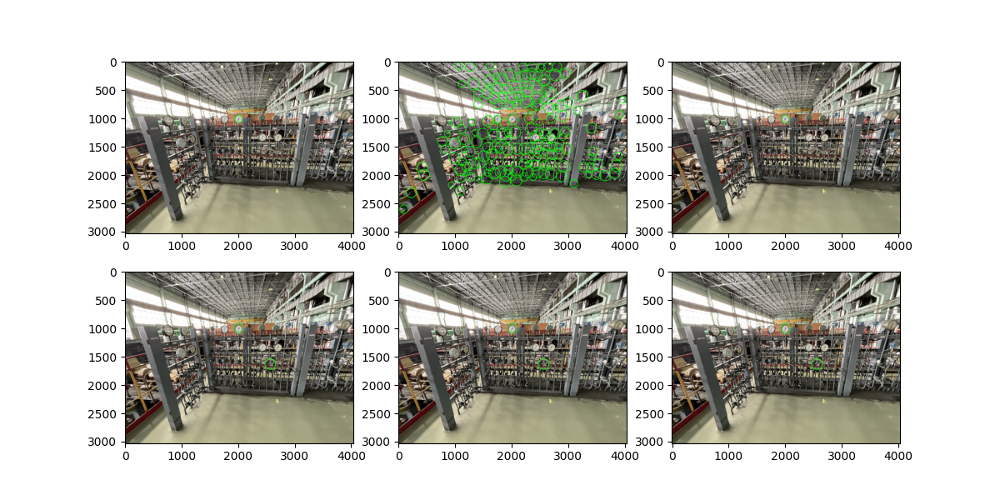

In [5]:
circles1 = cv2.HoughCircles(th4,cv2.HOUGH_GRADIENT,
                            dp=1,
                            minDist=100,
                            param1=30,
                            param2=50,
                            minRadius=50,
                            maxRadius=100)
circles2 = cv2.HoughCircles(img_gray,cv2.HOUGH_GRADIENT,
                            dp=1,
                            minDist=100,
                            param1=30,
                            param2=50,
                            minRadius=50,
                            maxRadius=100)
circles3 = cv2.HoughCircles(th6,cv2.HOUGH_GRADIENT,
                            dp=1,
                            minDist=100,
                            param1=30,
                            param2=50,
                            minRadius=50,
                            maxRadius=100)
circles4 = cv2.HoughCircles(th7,cv2.HOUGH_GRADIENT,
                            dp=1,
                            minDist=100,
                            param1=30,
                            param2=50,
                            minRadius=50,
                            maxRadius=100)
circles5 = cv2.HoughCircles(th7,cv2.HOUGH_GRADIENT,
                            dp=1,
                            minDist=100,
                            param1=30,
                            param2=50,
                            minRadius=50,
                            maxRadius=100)
circles6 = cv2.HoughCircles(th7,cv2.HOUGH_GRADIENT,
                            dp=1,
                            minDist=100,
                            param1=30,
                            param2=50,
                            minRadius=50,maxRadius=100)
circles = [circles1, circles2, circles3, circles4, circles5, circles6]
for j in range(6):
    if circles[j] is None:
        continue
    print(len(circles[j][0,:]))
    
plt.figure(figsize = (12,6))
disp_images = [None, None, None, None, None, None]
img_copy = img.copy()
for j in range(6):
    # print("j=", j)
    # print("circles[j][0,:]=", circles[j][0,:])
    disp_images[j] = img.copy()
    circles[j] = np.uint16(np.around(circles[j]))
    # print("disp_images[j]=", disp_images[j])
    # for i in circles[j][0,:]:
    #     # draw the outer circle
    #     cv2.circle(disp_images[j], (i[0],i[1]),i[2],(0,255,0),10)
    #     # draw the center of the circle
    #     cv2.circle(disp_images[j], (i[0],i[1]),2,(0,0,255),10)
    for cir in circles[j][0,:]:
        # print("i=", cir)
        center = (cir[0], cir[1])
        # print("center=", center)
        # draw the outer circle
        cv2.circle(disp_images[j], center,cir[2], (0,255,0), 10)
        # draw the center of the circle
        cv2.circle(disp_images[j], center, 2, (0,0,255), 10)
    # print(len(circles[j][0,:]))
    
    
    plt.subplot(2, 3, j+1)
    plt.imshow(disp_images[j], cmap='gray')

plt.show()

# Feature detection

https://github.com/deepanshut041/feature-detection

https://docs.opencv.org/4.x/dc/dc3/tutorial_py_matcher.html

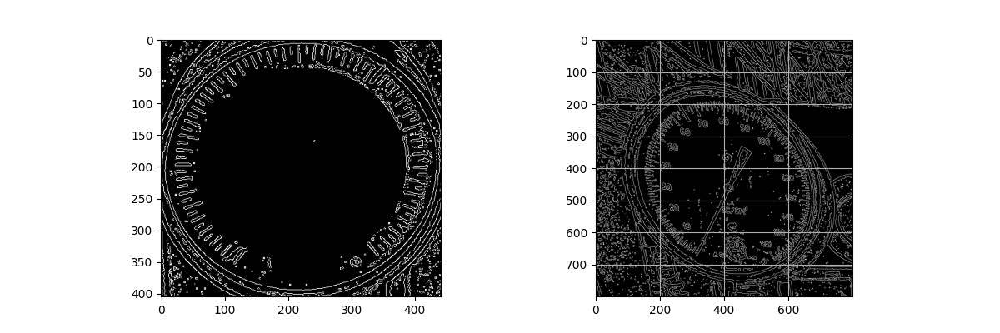

In [23]:
img_feature_sample = cv2.imread('images/Features_sample4.jpg')
img_feature_sample_gray = cv2.cvtColor(img_feature_sample, cv2.COLOR_BGR2GRAY)
img_feature_sample_gray = cv2.adaptiveThreshold(
    img_feature_sample_gray,255,cv2.ADAPTIVE_THRESH_MEAN_C,  
    cv2.THRESH_BINARY,15,5)
img_feature_sample_gray = cv2.Canny(img_feature_sample_gray, 50, 200, None, 3)

# img_feature_sample_gray = cv2.ximgproc.thinning(img_feature_sample_gray, cv2.ximgproc.THINNING_GUOHALL) # THINNING_ZHANGSUEN  THINNING_GUOHALL

pillow_image = Image.open("images/Манометр 23.heic")
img = np.array(pillow_image)
img = img[200:1000, 600:1400]
img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
img_gray = cv2.adaptiveThreshold(
    img_gray,255,cv2.ADAPTIVE_THRESH_MEAN_C,  
    cv2.THRESH_BINARY,15,5)
img_gray = cv2.Canny(img_gray, 50, 200, None, 3)

# img_gray = cv2.ximgproc.thinning(img_gray, cv2.ximgproc.THINNING_GUOHALL)
# img_gray = img_gray[200:1000, 600:1400]

plt.figure(figsize = (12,4))
plt.subplot(1,2,1)
plt.imshow(img_feature_sample_gray, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(img_gray, cmap='gray')
plt.grid()
plt.show()

## SIFT

C:\Users\1PC\AppData\Local\Temp\ipykernel_11656\1649739147.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (12,6))


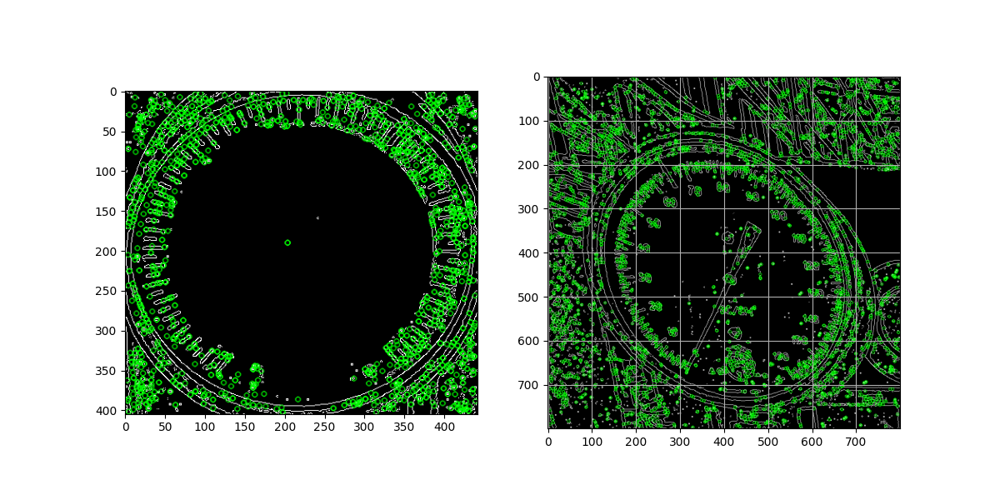

In [24]:
# Initiate SIFT detector
sift = cv2.SIFT_create(nfeatures = 5000, nOctaveLayers = 5)
# find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(img_feature_sample_gray,None)
kp2, des2 = sift.detectAndCompute(img_gray,None)

kp_image1 = cv2.drawKeypoints(img_feature_sample_gray, kp1, None, color=(0, 255, 0))
kp_image2 = cv2.drawKeypoints(img_gray, kp2, None, color=(0, 255, 0))

plt.figure(figsize = (12,6))
plt.subplot(1,2,1)
plt.imshow(kp_image1, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(kp_image2, cmap='gray')
plt.grid()
plt.show()

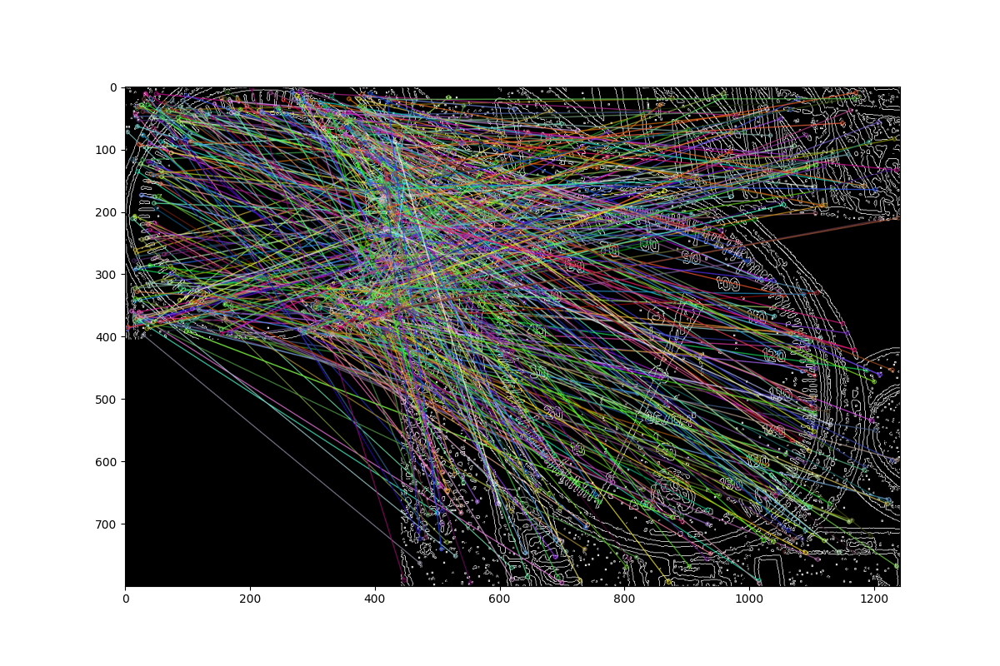

In [25]:
# BFMatcher with default params
# bf = cv2.BFMatcher()
# matches = bf.knnMatch(des1,des2,k=2)
# # Apply ratio test
# good = []
# for m,n in matches:
#     if m.distance < 0.9*n.distance:
#         good.append([m])
# # cv.drawMatchesKnn expects list of lists as matches.
# img3 = cv2.drawMatchesKnn(img_feature_sample_gray,kp1,
#                           img_gray,kp2,
#                           good,None,
#                           flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

#feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

matches = bf.match(des1,des2)
# matches = sorted(matches, key = lambda x:x.distance)
img3 = cv2.drawMatches(img_feature_sample_gray, kp1,
                       img_gray, kp2,
                       matches, img_feature_sample_gray, flags=2)

plt.figure(figsize = (12,8))
plt.imshow(img3)
plt.show()

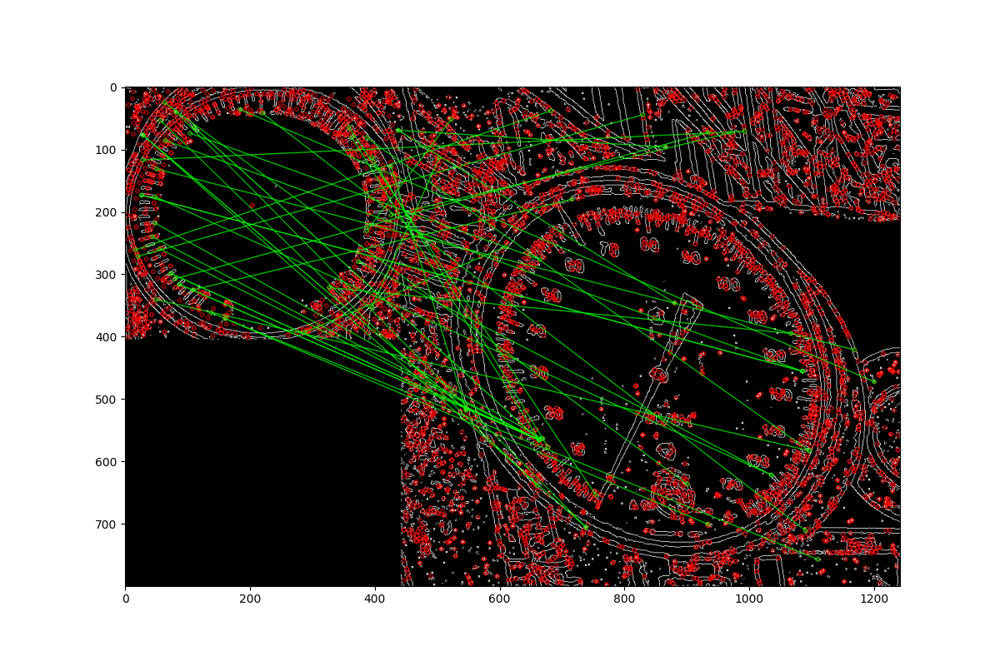

In [26]:
# FLANN parameters
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks=50)   # or pass empty dictionary
flann = cv2.FlannBasedMatcher(index_params,search_params)
matches = flann.knnMatch(des1,des2,k=2)
# Need to draw only good matches, so create a mask
matchesMask = [[0,0] for i in range(len(matches))]
# ratio test as per Lowe's paper
for i,(m,n) in enumerate(matches):
    if m.distance < 0.8*n.distance:
        matchesMask[i]=[1,0]
draw_params = dict(matchColor = (0,255,0),
                   singlePointColor = (255,0,0),
                   matchesMask = matchesMask,
                   flags = cv2.DrawMatchesFlags_DEFAULT)
img3 = cv2.drawMatchesKnn(img_feature_sample_gray,kp1,
                          img_gray,kp2,
                          matches,None,
                          **draw_params)
plt.figure(figsize = (12,8))
plt.imshow(img3)
plt.show()

## SURF

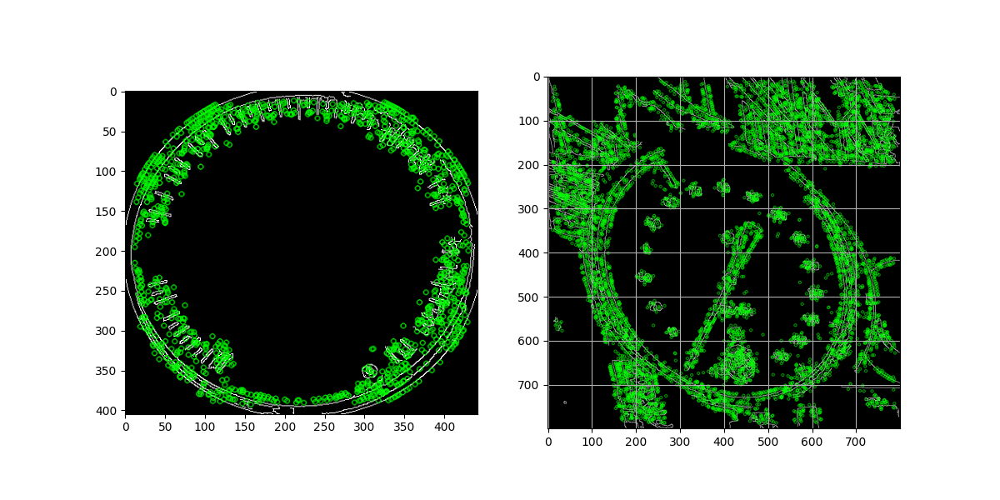

In [17]:
# detector = cv.xfeatures2d_SURF.create(hessianThreshold=minHessian)
# keypoints_obj, descriptors_obj = detector.detectAndCompute(img_object, None)
# keypoints_scene, descriptors_scene = detector.detectAndCompute(img_scene, None)

surf = cv2.xfeatures2d_SURF.create(400) # cv.xfeatures2d.SURF_create(400)
kp1, des1 = surf.detectAndCompute(img_feature_sample_gray, None)
kp2, des2 = surf.detectAndCompute(img_gray, None)

kp_image1 = cv2.drawKeypoints(img_feature_sample_gray, kp1, None, color=(0, 255, 0))
kp_image2 = cv2.drawKeypoints(img_gray, kp2, None, color=(0, 255, 0))

plt.figure(figsize = (12,6))
plt.subplot(1,2,1)
plt.imshow(kp_image1, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(kp_image2, cmap='gray')
plt.grid()
plt.show()

len(good) =  5


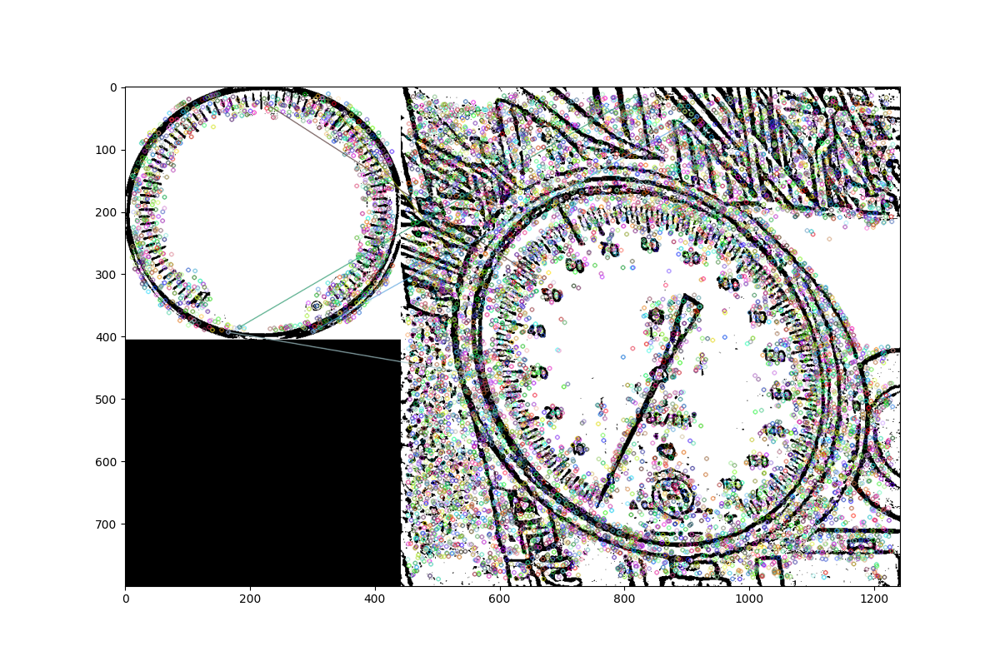

In [27]:
# FLANN parameters
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks=50)   # or pass empty dictionary
flann = cv2.FlannBasedMatcher(index_params,search_params)
# matches = flann.knnMatch(des1,des2,k=2)
matches = flann.knnMatch(des1,des2,k=2)
# Need to draw only good matches, so create a mask
matchesMask = [[0,0] for i in range(len(matches))]
# ratio test as per Lowe's paper

# for i,(m,n) in enumerate(matches):
#     if m.distance < 0.9*n.distance:
#         matchesMask[i]=[1,0]
        
good = []
for m,n in matches:
    if m.distance < 0.6*n.distance:
        good.append(m)
print("len(good) = ", len(good))

draw_params = dict(matchColor = (0,255,0),
                   singlePointColor = (255,0,0),
                   matchesMask = matchesMask,
                   flags = cv2.DrawMatchesFlags_DEFAULT)
img3 = cv2.drawMatches(img_feature_sample_gray,kp1,
                          img_gray,kp2,
                          good,None)
# img3 = cv2.drawMatchesKnn(img_feature_sample_gray,kp1,
#                           img_gray,kp2,
#                           matches,None)
plt.figure(figsize = (12,8))
plt.imshow(img3, cmap='gray')
plt.show()

len(good) =  637


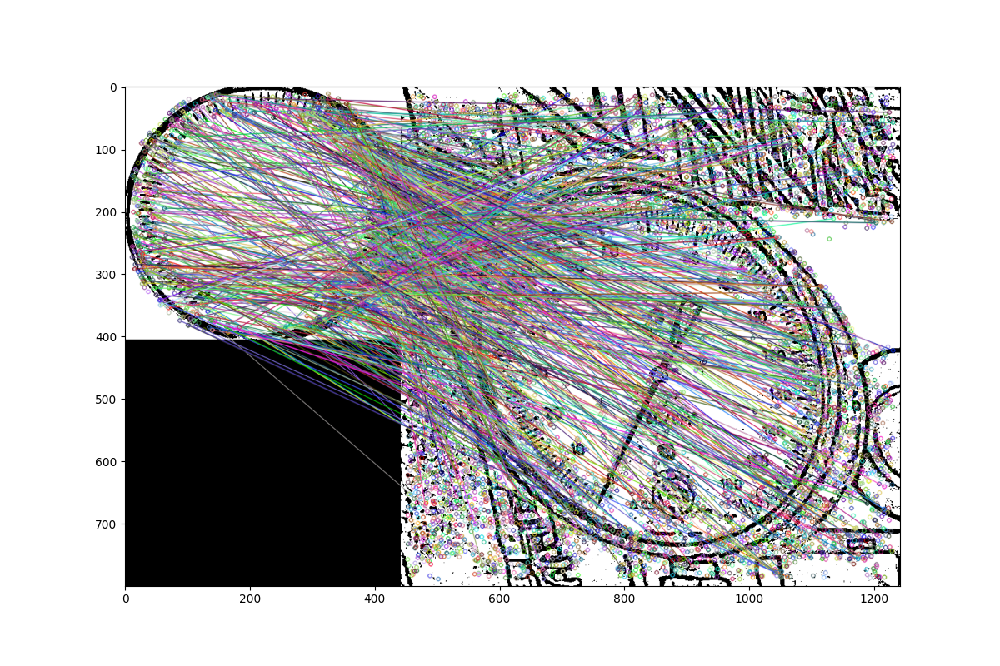

In [28]:
# https://docs.opencv.org/3.4/d1/de0/tutorial_py_feature_homography.html

good = []
for m,n in matches:
    if m.distance < 0.95*n.distance:
        good.append(m)
print("len(good) = ", len(good))
MIN_MATCH_COUNT = 10
if len(good)>MIN_MATCH_COUNT:
    src_pts = np.float32([ kp1[m.queryIdx].pt for m in good ]).reshape(-1,1,2)
    dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good ]).reshape(-1,1,2)
    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,5.0)
    matchesMask = mask.ravel().tolist()
    h,w = img_feature_sample_gray.shape
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    dst = cv2.perspectiveTransform(pts, M)
    img_gray2 = cv2.polylines(img_gray, [np.int32(dst)], True, 125, 10, cv2.LINE_AA)
else:
    print( "Not enough matches are found - {}/{}".format(len(good), MIN_MATCH_COUNT) )
    matchesMask = None
    
# img3 = cv2.drawMatchesKnn(img_feature_sample_gray, kp1,
#                           img_gray2, kp2,
#                           matches, None,
#                           **draw_params)
img3 = cv2.drawMatches(img_feature_sample_gray, kp1,
                          img_gray2, kp2,
                          good, None)
plt.figure(figsize = (12,8))
plt.imshow(img3)
plt.show()


## FAST

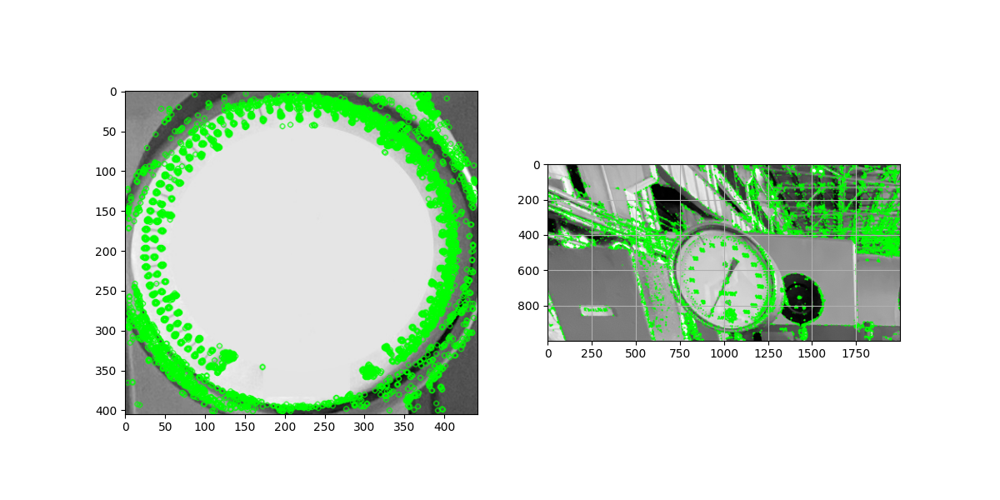

In [18]:
# Applying the function
fast = cv2.FastFeatureDetector_create()
fast.setNonmaxSuppression(False)
  
# Drawing the keypoints
kp1 = fast.detect(img_feature_sample, None)
kp2 = fast.detect(img_gray, None)

kp_image1 = cv2.drawKeypoints(img_feature_sample_gray, kp1, None, color=(0, 255, 0))
kp_image2 = cv2.drawKeypoints(img_gray, kp2, None, color=(0, 255, 0))

plt.figure(figsize = (12,6))
plt.subplot(1,2,1)
plt.imshow(kp_image1, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(kp_image2, cmap='gray')
plt.grid()
plt.show()

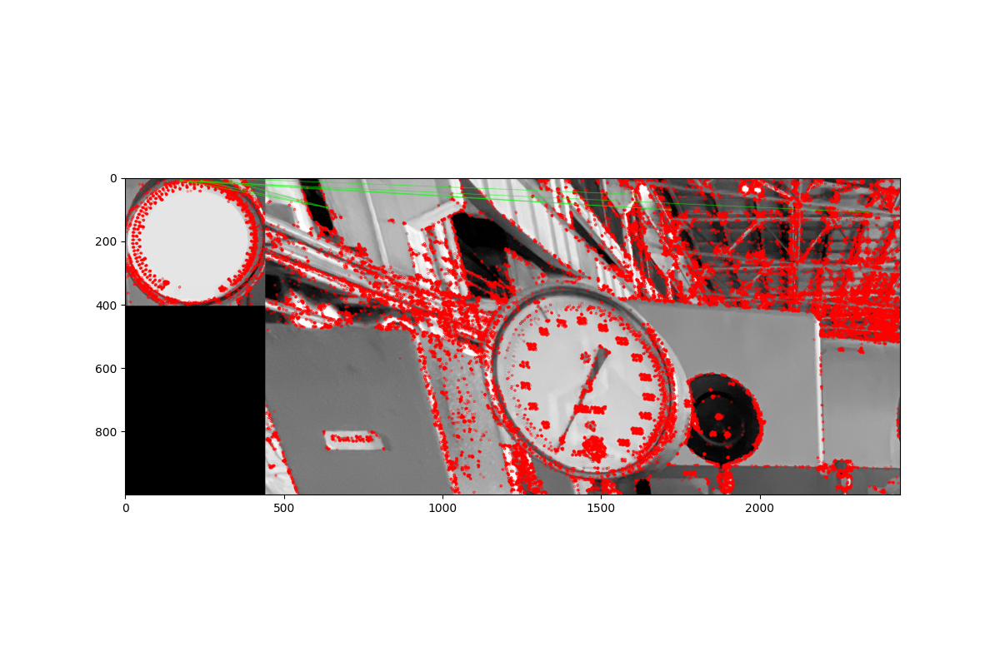

In [19]:
# FLANN parameters
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks=50)   # or pass empty dictionary
flann = cv2.FlannBasedMatcher(index_params,search_params)
matches = flann.knnMatch(des1,des2,k=2)
# Need to draw only good matches, so create a mask
matchesMask = [[0,0] for i in range(len(matches))]
# ratio test as per Lowe's paper
for i,(m,n) in enumerate(matches):
    if m.distance < 0.7*n.distance:
        matchesMask[i]=[1,0]
draw_params = dict(matchColor = (0,255,0),
                   singlePointColor = (255,0,0),
                   matchesMask = matchesMask,
                   flags = cv2.DrawMatchesFlags_DEFAULT)
img3 = cv2.drawMatchesKnn(img_feature_sample_gray,kp1,
                          img_gray,kp2,
                          matches,None,
                          **draw_params)
plt.figure(figsize = (12,8))
plt.imshow(img3)
plt.show()

## ORB

https://ai-facets.org/robust-logo-detection-with-opencv/

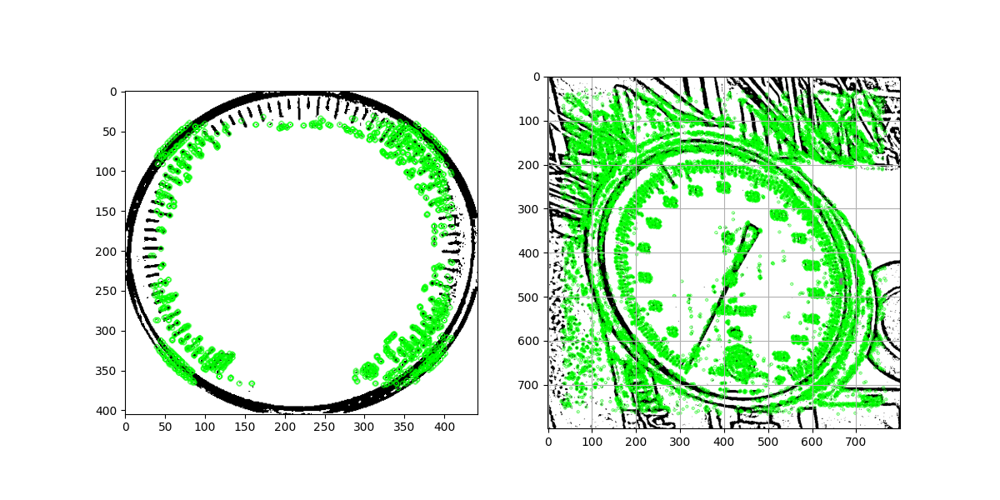

In [29]:
# Applying the function
orb = cv2.ORB_create(nfeatures=20000)
kp1, des1 = orb.detectAndCompute(img_feature_sample_gray, None)
kp2, des2 = orb.detectAndCompute(img_gray, None)
  
# Drawing the keypoints
kp_image1 = cv2.drawKeypoints(img_feature_sample_gray, kp1, None, color=(0, 255, 0), flags=0)
kp_image2 = cv2.drawKeypoints(img_gray, kp2, None, color=(0, 255, 0), flags=0)

plt.figure(figsize = (12,6))
plt.subplot(1,2,1)
plt.imshow(kp_image1, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(kp_image2, cmap='gray')
plt.grid()
plt.show()

len(matches)= 1357


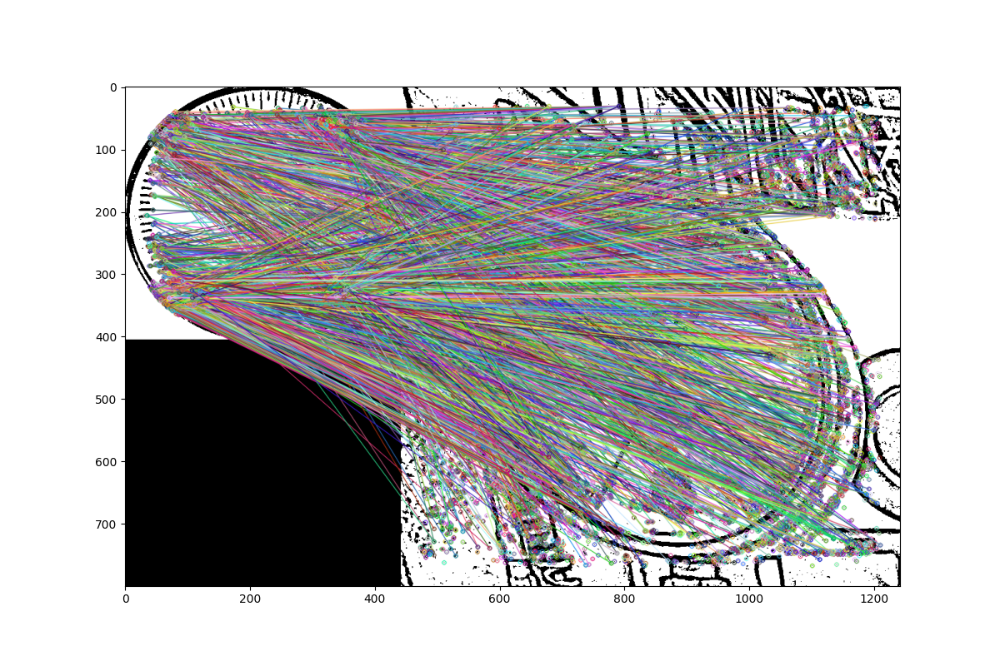

In [30]:
matcher = cv2.BFMatcher(cv2.NORM_HAMMING)#, crossCheck = True)

# matches = matcher.match(des1,des2)
# matches = sorted(matches, key = lambda x: x.distance)

matches = matcher.knnMatch(des1,des2, k=2)

print("len(matches)=", len(matches))
# draw the matches to the final image
# containing both the images the drawMatches()
# function takes both images and keypoints
# and outputs the matched query image with
# its train image
img3 = cv2.drawMatchesKnn(
        img_feature_sample_gray, kp1,
        img_gray, kp2,
        matches,None)
plt.figure(figsize = (12,8))
plt.imshow(img3)
plt.show()

In [147]:
matches[0][0]

TypeError: 'cv2.DMatch' object is not subscriptable

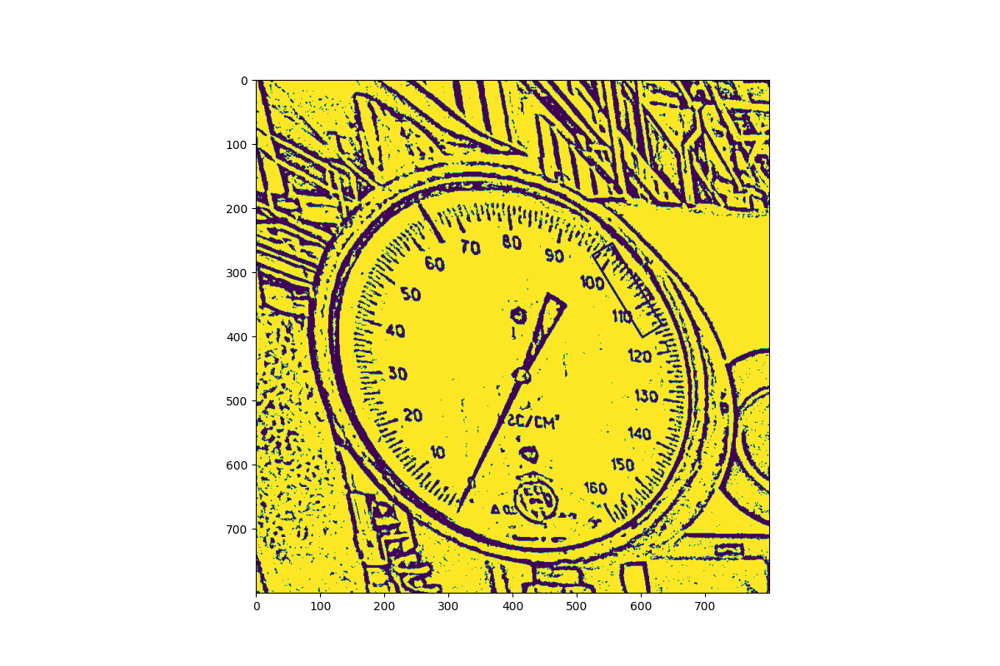

In [183]:
shape = img_feature_sample_gray.shape[:2][::-1]
good = []
# apply ratio test to matches of each keypoint
# idea is if train KP have a matching KP on image, it will be much closer than next closest non-matching KP,
# otherwise, all KPs will be almost equally far
for m, n in matches:
    if m.distance < 0.8 * n.distance:
        good.append([m])
# stop if we didn't find enough matching keypoints
# if len(good) < 0.1 * len(train_kps):
#     return None
# estimate a transformation matrix which maps keypoints from train image coordinates to sample image
src_pts = np.float32([kp1[m[0].queryIdx].pt for m in good
                      ]).reshape(-1, 1, 2)
dst_pts = np.float32([kp2[m[0].trainIdx].pt for m in good
                      ]).reshape(-1, 1, 2)
m, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
if m is not None:
    # apply perspective transform to train image corners to get a bounding box coordinates on a sample image
    scene_points = cv2.perspectiveTransform(
        np.float32([(0, 0), (0, shape[0] - 1),
                    (shape[1] - 1, shape[0] - 1),
                    (shape[1] - 1, 0)]).reshape(-1, 1, 2),
        m)
    rect = cv2.minAreaRect(scene_points)

    box = cv2.boxPoints(rect)
    box = np.int0(box)
    img3 = img_gray.copy()
    cv2.drawContours(img3, [box], 0, (0, 255, 0), 2)

plt.figure(figsize = (12,8))
plt.imshow(img3)
plt.show()


# RANSAC Ellipse Fitting

https://iust-projects.ir/post/dip06/

# [+] Наклон стрелки

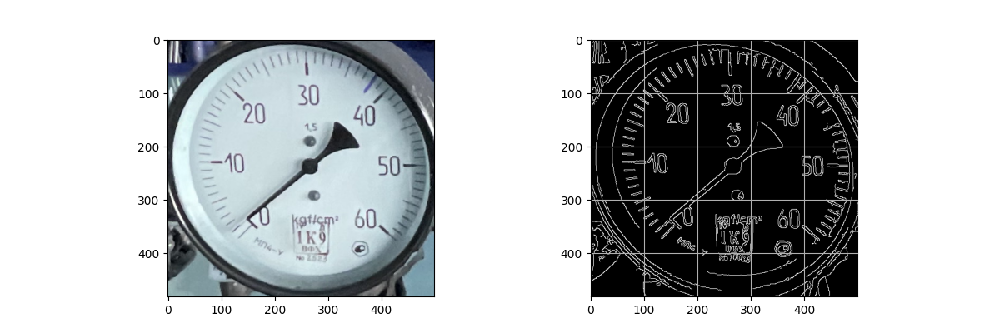

In [12]:
# заранее подготовленный фрагмент крупным планом
img_feature_sample = cv2.imread('images/Features_sample3.jpg')
img_feature_sample_gray = cv2.cvtColor(img_feature_sample, cv2.COLOR_BGR2GRAY)

canny = cv2.Canny(img_feature_sample_gray, 50, 200, None, 3)

plt.figure(figsize = (12,4))
plt.subplot(1,2,1)
plt.imshow(img_feature_sample, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(canny, cmap='gray')
plt.grid()
plt.show()

## HoughLines

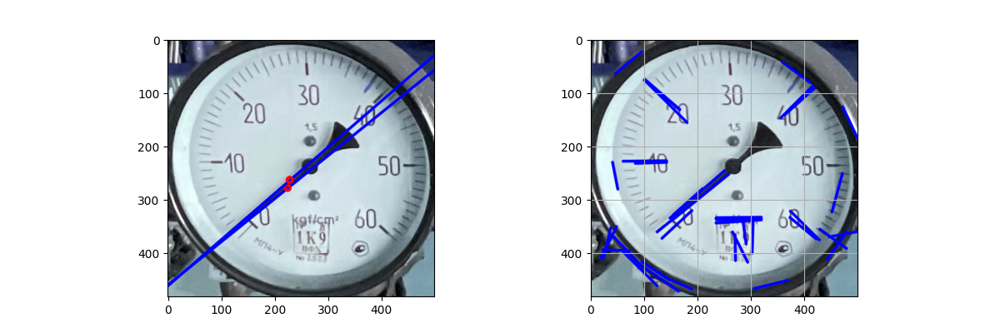

In [13]:
lines = cv2.HoughLines(canny,
                       rho=1, # Distance resolution of the accumulator in pixels.
                       theta=np.pi / 180, # Angle resolution of the accumulator in radians.
                       threshold=150,
                       srn =None,
                       stn = 0,
                       min_theta =0)

# отметить линии на копии изображения
cdst = img_feature_sample.copy()

if lines is not None:
    for i in range(0, len(lines)):
        rho = lines[i][0][0]
        theta = lines[i][0][1]
        a = math.cos(theta)
        b = math.sin(theta)
        x0 = a * rho
        y0 = b * rho
        center = int(x0), int(y0)
        pt1 = (int(x0 + 1000*(-b)), int(y0 + 1000*(a)))
        pt2 = (int(x0 - 1000*(-b)), int(y0 - 1000*(a)))
        cv2.line(cdst, pt1, pt2, (0,0,255), 3, cv2.LINE_AA)
        cv2.circle(cdst, center=center, radius=5, color=(255,0,0), thickness=3)



linesP = cv2.HoughLinesP(canny, 1, np.pi / 180, 50, None, 50, 10)
# print("linesP = ", linesP)

cdstP = img_feature_sample.copy()

if linesP is not None:
    for i in range(0, len(linesP)):
        l = linesP[i][0]
        cv2.line(cdstP, (l[0], l[1]), (l[2], l[3]), (0,0,255), 3, cv2.LINE_AA)

plt.figure(figsize = (12,4))
plt.subplot(1,2,1)
plt.imshow(cdst, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(cdstP, cmap='gray')
plt.grid()
plt.show()

## Фильтрация найденных линий

centerXY= [250 240]
distance_tol= 24.05



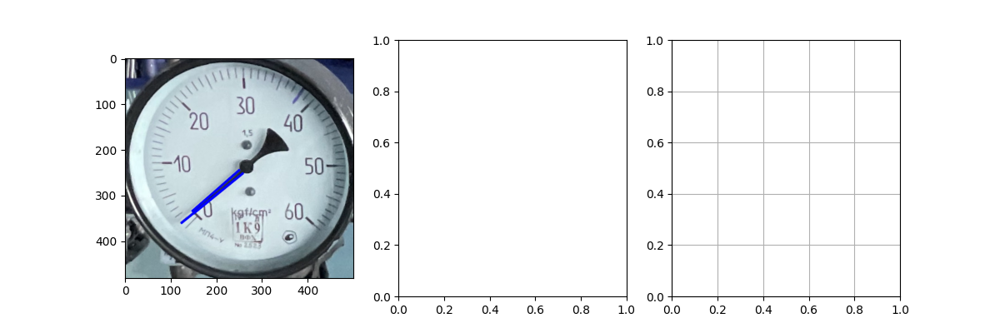

In [14]:
height = canny.shape[0]
width = canny.shape[1]

centerYX = np.array([height // 2, width // 2])
centerXY = np.array([width // 2, height // 2])
print("centerXY=", centerXY)

# проходящие близко к центру (расстояние между линией и центром < x)
distance_tol = min(height, width) * 0.05
print("distance_tol=", distance_tol)
print("")

# начинающиеся близко от центра (расстояние между линией и центром < x)

cdstP = img_feature_sample.copy()
approved_lines = []
for line in linesP:
    # print("line[0,0:1]=", line[0,0:2])
    delta1 = centerYX - line[0][0:2] # np.subtract(line[0,0:2], centerXY)
    delta2 = centerYX - line[0][2:4]
    # print("delta1=", delta1)
    # print("delta2=", delta2)
    min_dist = min(np.linalg.norm(delta1), np.linalg.norm(delta2))
    
    
    # print("dist=", min_dist)
    if min_dist < distance_tol:
        approved_lines.append(line)
    # print("")
if approved_lines is not None:
    for i in range(0, len(approved_lines)):
        l = approved_lines[i][0]
        cv2.line(cdstP, (l[0], l[1]), (l[2], l[3]), (0,0,255), 3, cv2.LINE_AA)
        
plt.figure(figsize = (12,4))
plt.subplot(1,3,1)
plt.imshow(cdstP)

# самые ближние к центру

# группировка линий, имеющих небольшой разброс по расстоянию и углу

# печать угла



plt.subplot(1,3,2)
plt.subplot(1,3,3)

plt.grid()
plt.show()

# OCR

## Детектирование надписей

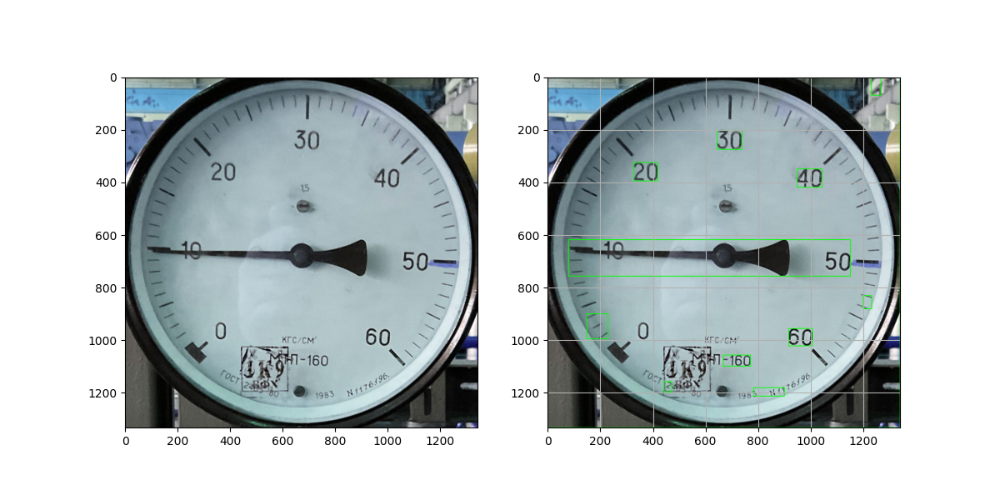

In [18]:
import pytesseract
import sys, os

pytesseract.pytesseract.tesseract_cmd='C:\\Program Files\\Tesseract-OCR\\tesseract.exe'
# бинарники https://tesseract-ocr.github.io/tessdoc/Home.html

# PSM Page segmentation modes:

# 0. Orientation and script detection (OSD) only.
# 1. Automatic page segmentation with OSD.
# Automatic page segmentation, but no OSD, or OCR. (not implemented)
# Fully automatic page segmentation, but no OSD. (Default)
# Assume a single column of text of variable sizes.
# Assume a single uniform block of vertically aligned text.
# Assume a single uniform block of text.
# 8. Treat the image as a single text line.
# 9. Treat the image as a single word.
# 10. Treat the image as a single word in a circle.
# 11. Treat the image as a single character.
# 12. Sparse text. Find as much text as possible in no particular order.
# 13. Sparse text with OSD.
# 14. Raw line. Treat the image as a single text line, bypassing hacks that are Tesseract-specific.

# OEMOCR Engine modes:
# 
# 0. Legacy engine only.
# 1. Neural nets LSTM engine only.
# 2. Legacy + LSTM engines.
# 3. Default, based on what is available.


# pil_image=Image.open("images/Features_sample1.jpg", mode = 'r')
img = cv2.imread('images/Features_sample2.jpg')
pil_image=Image.fromarray(img)

configstr = '--psm 12 --oem 3 -c tessedit_char_whitelist=0123456789'
pytesseract_str = pytesseract.image_to_string(pil_image, lang="eng",
                                              # config='numbers',
                                              config=configstr) # собственно, OCR
data = pytesseract.image_to_data(pil_image,
                                 lang="eng",
                                 output_type='dict',
                                 config=configstr)

# print("text=", pytesseract_str.lower())
# print("data=", data)

img2 = img.copy()
boxes = len(data['level'])
for i in range(boxes ):
    (x, y, w, h) = (data['left'][i], data['top'][i], data['width'][i], data['height'][i])
    #Draw box        
    cv2.rectangle(img2, (x, y), (x + w, y + h), (0, 255, 0), 2)
    
# pil_image=Image.fromarray(img_gray)
plt.figure(figsize = (12,6))
plt.subplot(1,2,1)
plt.imshow(pil_image)
plt.subplot(1,2,2)
plt.imshow(img2)
plt.grid()
plt.show()

## Фильтрация надписей

# Test

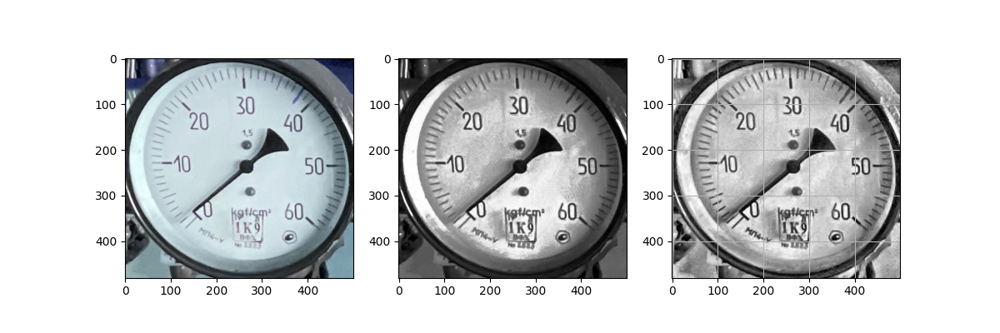

In [75]:
img_feature_sample = cv2.imread('images/Features_sample3.jpg')
img_feature_sample_gray = cv2.cvtColor(img_feature_sample, cv2.COLOR_BGR2GRAY)

# (the contrast is pretty good already, so not much change, but good habit to have here)
img_equalized = cv2.equalizeHist(img_feature_sample_gray)

clahe = cv2.createCLAHE(clipLimit=5, tileGridSize=(8, 8))
img_clahe = clahe.apply(img_feature_sample_gray)
# clahe = cv2.createCLAHE(clipLimit = 10) 

plt.figure(figsize = (12,4))
plt.subplot(1,3,1)
plt.imshow(img_feature_sample, cmap='gray')
plt.subplot(1,3,2)
plt.imshow(img_equalized, cmap='gray')
plt.subplot(1,3,3)
plt.imshow(img_clahe, cmap='gray')
plt.grid()
plt.show()

# [-] HOG + SVM

https://cvexplained.wordpress.com/tag/object-detection/

Требуется обучение по большому кол-ву изображений, ничем не лучше НС

# [-] CascadeClassifier + detectMultiScale

Нужно обучать, для залитых изображений (не контурных)

# fitEllipse

In [ ]:
img_feature_sample = cv2.imread('images/Features_sample4.jpg')
img_feature_sample_gray = cv2.cvtColor(img_feature_sample, cv2.COLOR_BGR2GRAY)
img_feature_sample_gray = cv2.adaptiveThreshold(
    img_feature_sample_gray,255,cv2.ADAPTIVE_THRESH_MEAN_C,  
    cv2.THRESH_BINARY,15,5)

canny_output = cv2.Canny(img_feature_sample_gray, threshold, threshold * 2)


_, contours, _ = cv2.findContours(canny_output, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

# Find the rotated rectangles and ellipses for each contour
minRect = [None]*len(contours)
minEllipse = [None]*len(contours)
for i, c in enumerate(contours):
    minRect[i] = cv2.minAreaRect(c)
    if c.shape[0] > 5:
        minEllipse[i] = cv2.fitEllipse(c)
# Draw contours + rotated rects + ellipses

drawing = np.zeros((canny_output.shape[0], canny_output.shape[1], 3), dtype=np.uint8)

for i, c in enumerate(contours):
    color = (rng.randint(0,256), rng.randint(0,256), rng.randint(0,256))
    # contour
    cv2.drawContours(drawing, contours, i, color)
    # ellipse
    if c.shape[0] > 5:
        cv2.ellipse(drawing, minEllipse[i], color, 2)
    # rotated rectangle
    box = cv2.boxPoints(minRect[i])
    box = np.intp(box) #np.intp: Integer used for indexing (same as C ssize_t; normally either int32 or int64)
    cv2.drawContours(drawing, [box], 0, color)

# END